# Bibliotecas requeridas.

In [11]:
%pip install ktrain
%pip install seaborn


   ---------------------------------------- 0.0/294.6 kB ? eta -:--:--
   --------------- ------------------------ 112.6/294.6 kB 2.2 MB/s eta 0:00:01
   ---------------------------------------- 294.6/294.6 kB 3.0 MB/s eta 0:00:00


# *Imports* e configurações.

In [1]:
import os
import warnings
warnings.filterwarnings('ignore')

# Configurações de ambiente
os.environ['DISABLE_V2_BEHAVIOR'] = '1'
os.environ["CUDA_DEVICE_ORDER"] = "PCI_BUS_ID"
os.environ["CUDA_VISIBLE_DEVICES"] = "0"

# Bibliotecas do ktrain
import ktrain
from ktrain import vision as vis

# Scikit-learn
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix

# Outras bibliotecas
import shutil
import numpy as np

# Bibliotecas para plots
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import seaborn as sns
%matplotlib inline

Instructions for updating:
non-resource variables are not supported in the long term
Using DISABLE_V2_BEHAVIOR with TensorFlow


c:\Users\mathe\OneDrive\Documents\Faculdade\PML\trab\.venv\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


# Separando treino e teste
Esta célula de código foi executado somente uma vez com o propósito<br>
de separar o *dataset* em treino e teste, com uma proporção de 20%<br>
para o teste e 80% para o treino.

Altere as variáveis `original_directory`, `train_destination_directory` e `test_destination_directory`<br>
de acordo com os seus diretórios.

Na variável `original_directory` espera-se receber um diretório como o abaixo:
- dataset/
  - cats/
  - dogs/


In [2]:
def create_directories(train_destination, test_destination, classes):
    for class_name in classes:
        os.makedirs(os.path.join(train_destination, class_name), exist_ok=True)
        os.makedirs(os.path.join(test_destination, class_name), exist_ok=True)

def move_images(source, destination, images):
    for image in images:
        source_image = os.path.join(source, image)
        destination_image = os.path.join(destination, image)
        shutil.copy(source_image, destination_image)

# Diretório original que contém todas imagens
original_directory = 'C:\\Users\\mathe\\OneDrive\\Documents\\Faculdade\\PML\\tudo'

# Diretório de destino para imagens de treino e teste
train_destination_directory = 'C:\\Users\\mathe\\OneDrive\\Documents\\Faculdade\\PML\\dataset\\train'
test_destination_directory = 'C:\\Users\\mathe\\OneDrive\\Documents\\Faculdade\\PML\\dataset\\test'

dog_images = os.listdir(os.path.join(original_directory, 'dogs'))
cat_images = os.listdir(os.path.join(original_directory, 'cats'))

# Divide as imagens em conjuntos de treino e teste
train_dogs, test_dogs = train_test_split(dog_images, test_size=0.2)
train_cats, test_cats = train_test_split(cat_images, test_size=0.2)

# Cria diretórios de destino, se não existirem
classes_list = ['dogs', 'cats']
create_directories(train_destination_directory, test_destination_directory, classes_list)

move_images(os.path.join(original_directory, 'dogs'), os.path.join(train_destination_directory, 'dogs'), train_dogs)
move_images(os.path.join(original_directory, 'cats'), os.path.join(train_destination_directory, 'cats'), train_cats)

move_images(os.path.join(original_directory, 'dogs'), os.path.join(test_destination_directory, 'dogs'), test_dogs)
move_images(os.path.join(original_directory, 'cats'), os.path.join(test_destination_directory, 'cats'), test_cats)


# Construindo conjuntos de treino e validação.

In [2]:
(train_data, val_data, preproc) = vis.images_from_folder(
                                              datadir='C:\\Users\\mathe\\OneDrive\\Documents\\Faculdade\\PML\\dataset',
                                              data_aug = vis.get_data_aug(horizontal_flip=True),
                                              train_test_names=['train', 'test'],
                                              target_size=(224,224), color_mode='rgb')

Found 29789 images belonging to 2 classes.
Found 29789 images belonging to 2 classes.
Found 7449 images belonging to 2 classes.


In [ ]:
vis.print_image_classifiers()

### Escolha entre uma das duas células de código abaixo de acordo se deseja executar os modelos A ou B.

Modelo A:

In [3]:
model = vis.image_classifier('pretrained_resnet50', train_data, val_data)

The normalization scheme has been changed for use with a pretrained_resnet50 model. If you decide to use a different model, please reload your dataset with a ktrain.vision.data.images_from* function.

Is Multi-Label? False
Is Regression? False
pretrained_resnet50 model created.


Modelo B:

In [ ]:
model = vis.image_classifier('pretrained_mobilenetv3', train_data, val_data)

# Preparando o modelo.
Linhas de código comentadas com base nas 4 variacões de modelos que foram treinados.

In [4]:
learner = ktrain.get_learner(model=model, train_data=train_data, val_data=val_data, workers = 4, use_multiprocessing=False, batch_size=32)

Comente ou descomente as linhas da célula abaixo para utilizar o modelo desejado.

In [ ]:
learner.freeze(freeze_range=14) # Modelo A1
# learner.freeze(freeze_range=88) # Modelo A2
# Modelo A3 e B nao foi utilizado freeze

learner.print_layers()

# Estimando a taxa de aprendizado.<br>
Esta célula foi executada apenas uma vez durante o desenvolvimento do modelo A1
para estimar a taxa de aprendizado que foi utilizada em todos os outros modelos.

simulating training for different learning rates... this may take a few moments...
Epoch 1/15
930/930 [==============================] - 227s 236ms/step - batch: 464.5000 - size: 31.9968 - loss: 1.7349 - acc: 0.5421
Epoch 2/15
930/930 [==============================] - 206s 221ms/step - batch: 464.5000 - size: 31.9968 - loss: 1.0174 - acc: 0.7010
Epoch 3/15
930/930 [==============================] - 201s 216ms/step - batch: 464.5000 - size: 31.9968 - loss: 0.4509 - acc: 0.8637
Epoch 4/15
930/930 [==============================] - 196s 211ms/step - batch: 464.5000 - size: 31.9968 - loss: 0.1957 - acc: 0.9457
Epoch 5/15
930/930 [==============================] - 197s 212ms/step - batch: 464.5000 - size: 31.9968 - loss: 0.1196 - acc: 0.9672
Epoch 6/15
930/930 [==============================] - 191s 205ms/step - batch: 464.5000 - size: 31.9968 - loss: 0.1075 - acc: 0.9687
Epoch 7/15
930/930 [==============================] - 103s 111ms/step - batch: 250.0000 - size: 31.9940 - loss: 0.1231 

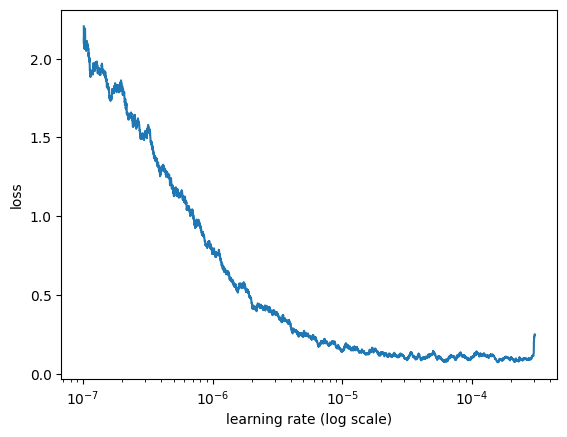

In [6]:
learner.lr_find(max_epochs=15)
learner.lr_plot()

# Treinando o modelo.

In [7]:
learner.fit_onecycle(0.00012, epochs=15)



begin training using onecycle policy with max lr of 0.00012...
Epoch 1/15
931/931 [==============================] - 235s 240ms/step - batch: 465.0000 - size: 31.9968 - loss: 0.2685 - acc: 0.9256 - val_loss: 0.0432 - val_acc: 0.9893
Epoch 2/15
931/931 [==============================] - 219s 236ms/step - batch: 465.0000 - size: 31.9968 - loss: 0.0962 - acc: 0.9749 - val_loss: 0.0437 - val_acc: 0.9891
Epoch 3/15
931/931 [==============================] - 219s 235ms/step - batch: 465.0000 - size: 31.9968 - loss: 0.0747 - acc: 0.9782 - val_loss: 0.0341 - val_acc: 0.9901
Epoch 4/15
931/931 [==============================] - 232s 249ms/step - batch: 465.0000 - size: 31.9968 - loss: 0.0598 - acc: 0.9797 - val_loss: 0.0608 - val_acc: 0.9819
Epoch 5/15
931/931 [==============================] - 231s 248ms/step - batch: 465.0000 - size: 31.9968 - loss: 0.0632 - acc: 0.9783 - val_loss: 0.0342 - val_acc: 0.9887
Epoch 6/15
931/931 [==============================] - 228s 245ms/step - batch: 465.00

# Medindo acurácia e *loss* final.

In [8]:
loss, acc = learner.model.evaluate_generator(learner.val_data, steps=len(learner.val_data))
print('final loss:%s, final accuracy:%s' % (loss, acc))

final loss:0.029000513223961362, final accuracy:0.9920795


# Obtendo o histórico de acurácia e *loss* do treinamento.

In [9]:
# Obter o histórico de métricas
history = learner.history.history

acc = history['acc']
val_acc = history['val_acc']
loss = history['loss']
val_loss = history['val_loss']

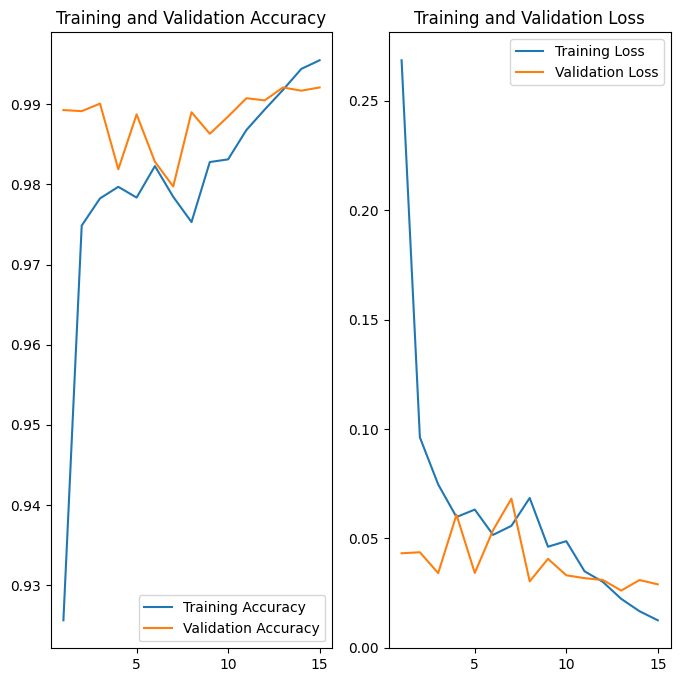

In [10]:
epochs_range = range(1, len(acc) + 1)

plt.figure(figsize=(8, 8))
plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.show()

# Gerando a matriz de confusão.

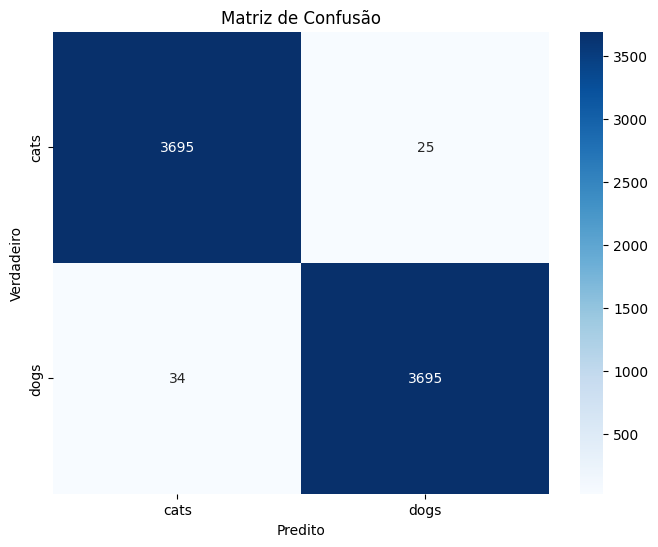

In [13]:
y_pred = learner.predict(val_data)

y_pred = np.argmax(y_pred, axis=1)
y_true = np.array(val_data.labels)

cm = confusion_matrix(y_true, y_pred)

plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=['cats', 'dogs'], yticklabels=['cats', 'dogs'])
plt.title('Matriz de Confusão')
plt.xlabel('Predito')
plt.ylabel('Verdadeiro')
plt.show()

## Predizendo imagens.

In [14]:
predictor = ktrain.get_predictor(learner.model, preproc)

In [5]:
# Define um nome para o modelo caso queira salva-lo
nome_modelo = 'resnet50A1'

In [16]:
# Salvar o modelo caso queira
predictor.save('C:\\Users\\mathe\\OneDrive\\Documents\\Faculdade\\PML\\trab\\' + nome_modelo)

In [6]:
# Carregar o modelo previamente salvo
predictor = ktrain.load_predictor('C:\\Users\\mathe\\OneDrive\\Documents\\Faculdade\\PML\\trab\\' + nome_modelo)

# Verificando e analisando erros de classificação.

### Cachorros que foram classificados como gatos.

In [7]:
results_dogs = predictor.predict_folder('C:\\Users\\mathe\\OneDrive\\Documents\\Faculdade\\PML\\dataset\\test\\dogs', return_proba=True)

Found 3729 images belonging to 1 classes.


É possível observar que o *dataset* possui erros de rotulamento em seus dados.

In [8]:
cats = []

for element in results_dogs:
    if element[1][1] < 0.5 :
        cats.append(element)

print(len(cats))

34


File classified 'dogs\dog (2053).jpg' as 'CAT' [0.71787554 0.28212443]


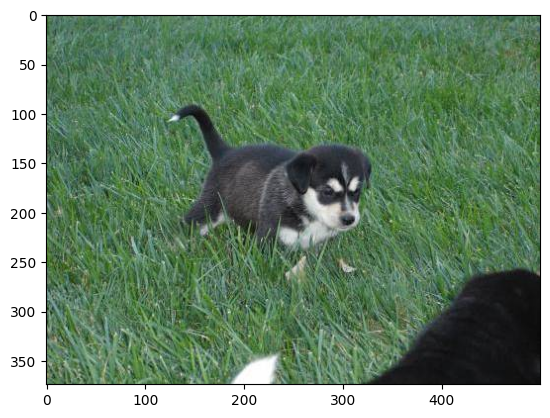

File classified 'dogs\dog (3399).jpg' as 'CAT' [0.86229026 0.1377097 ]


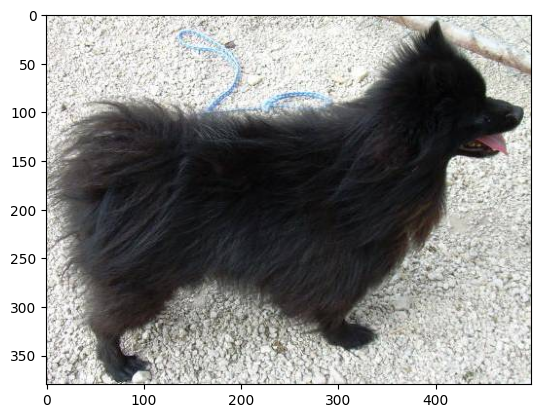

File classified 'dogs\dog (4185).jpg' as 'CAT' [0.7015336  0.29846632]


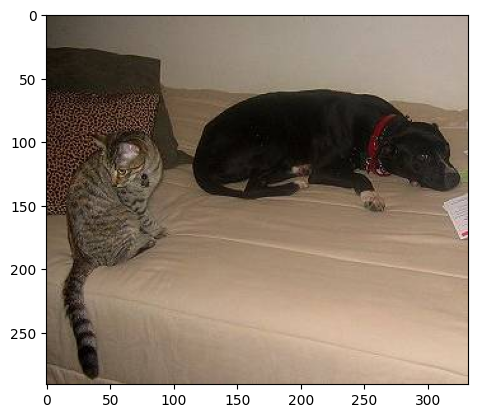

File classified 'dogs\dog (4647).jpg' as 'CAT' [0.51531357 0.4846864 ]


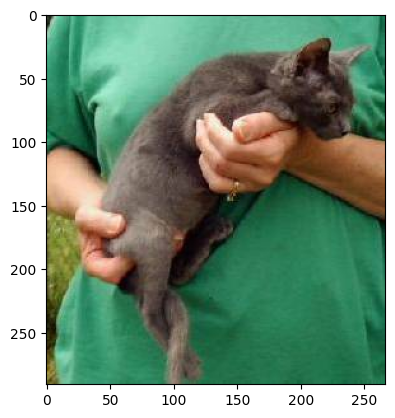

File classified 'dogs\dog (5020).jpg' as 'CAT' [0.68246853 0.31753144]


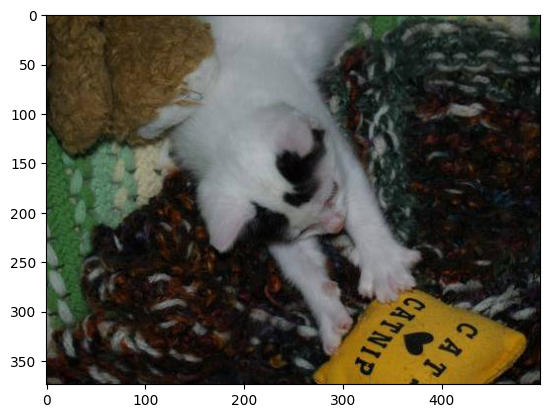

File classified 'dogs\dog (5189).jpg' as 'CAT' [9.9967718e-01 3.2280004e-04]


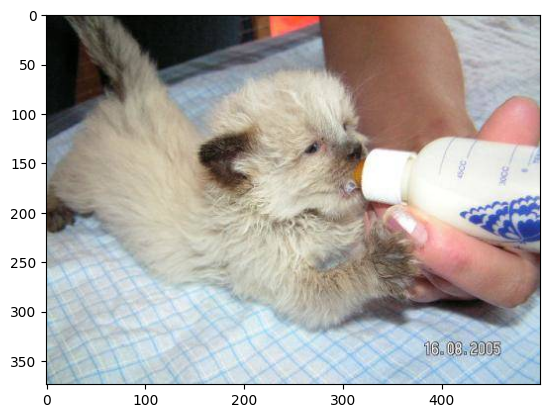

File classified 'dogs\dog (5513).jpg' as 'CAT' [0.57230407 0.42769593]


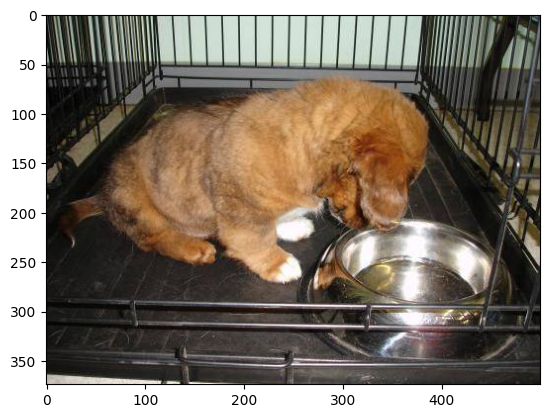

File classified 'dogs\dog (5762).jpg' as 'CAT' [0.9957528  0.00424722]


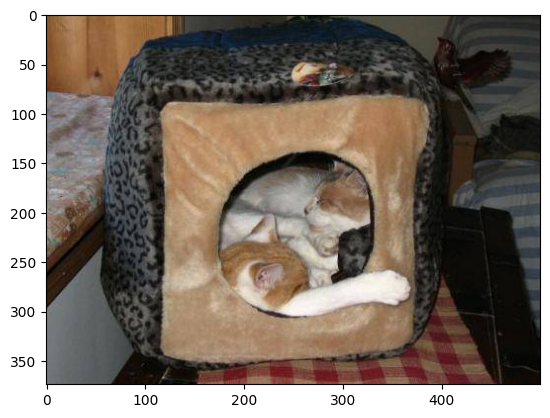

File classified 'dogs\dog (5988).jpg' as 'CAT' [0.5230933  0.47690678]


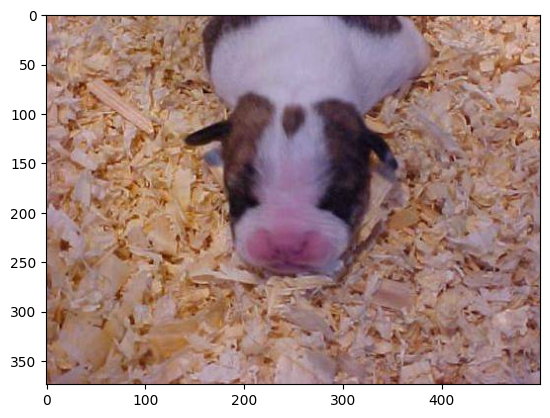

File classified 'dogs\dog (6058).jpg' as 'CAT' [0.99407613 0.00592387]


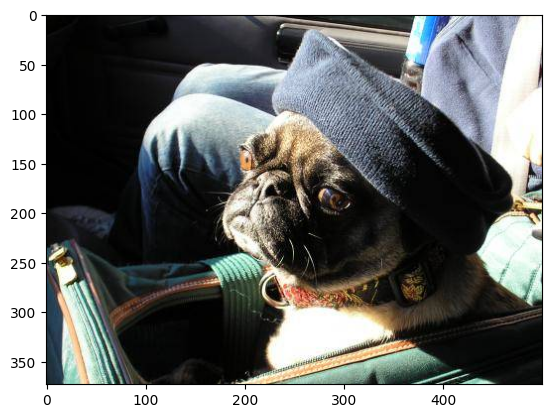

File classified 'dogs\dog (926).jpg' as 'CAT' [0.72789776 0.2721023 ]


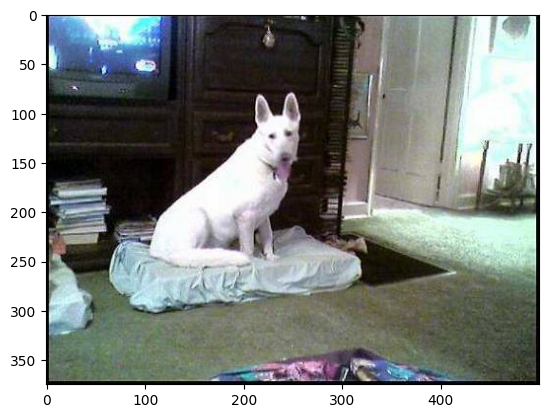

File classified 'dogs\dog.1069.jpg' as 'CAT' [0.74389815 0.25610182]


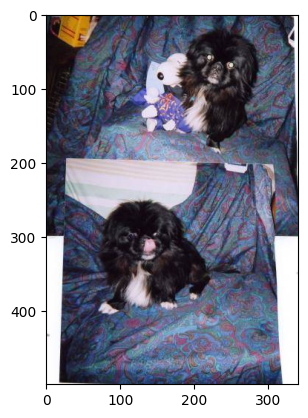

File classified 'dogs\dog.10690.jpg' as 'CAT' [0.5854586  0.41454142]


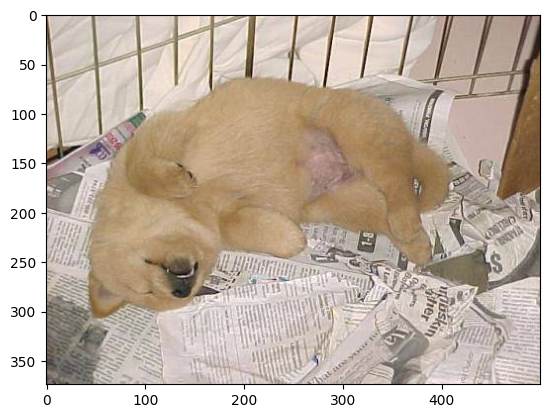

File classified 'dogs\dog.11731.jpg' as 'CAT' [0.5772367  0.42276332]


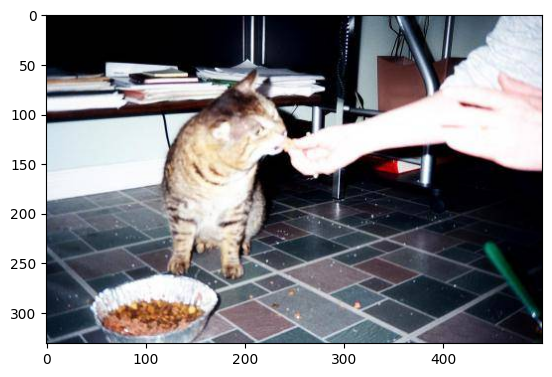

File classified 'dogs\dog.12322.jpg' as 'CAT' [0.5259312  0.47406876]


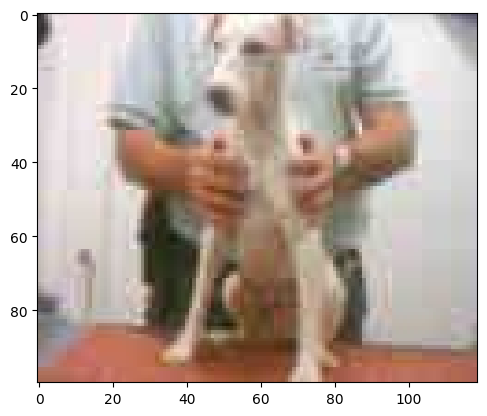

File classified 'dogs\dog.2458.jpg' as 'CAT' [0.9822326 0.0177674]


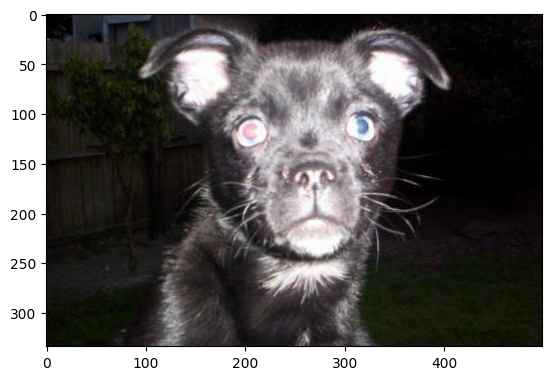

File classified 'dogs\dog.2712.jpg' as 'CAT' [0.9933924  0.00660756]


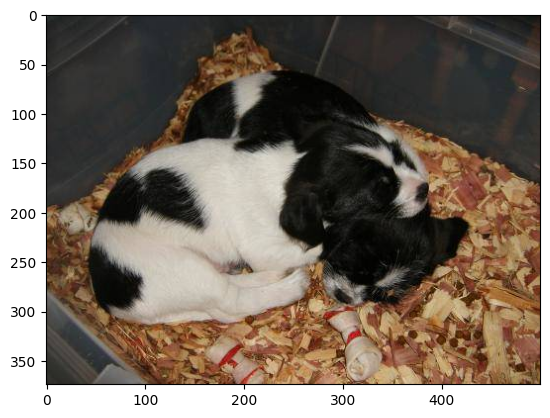

File classified 'dogs\dog.3756.jpg' as 'CAT' [0.81971586 0.18028419]


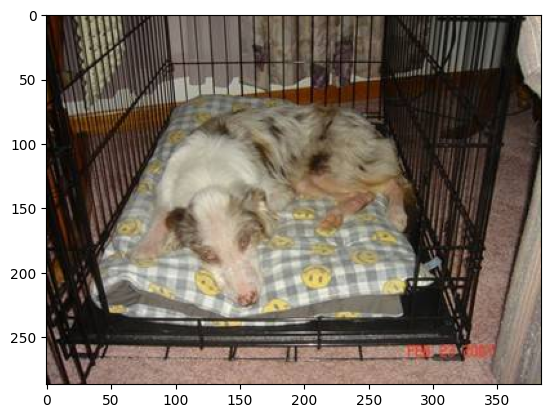

File classified 'dogs\dog.3759.jpg' as 'CAT' [9.999999e-01 8.360256e-08]


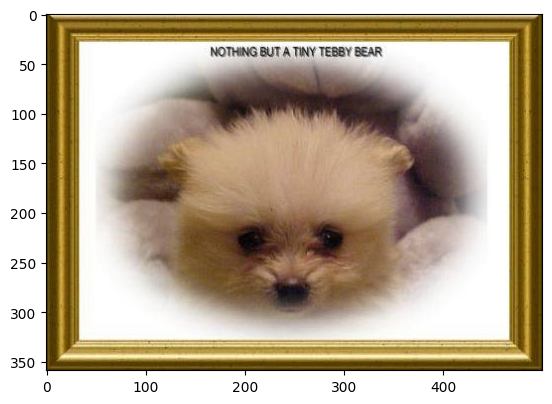

File classified 'dogs\dog.4616.jpg' as 'CAT' [0.9978435  0.00215652]


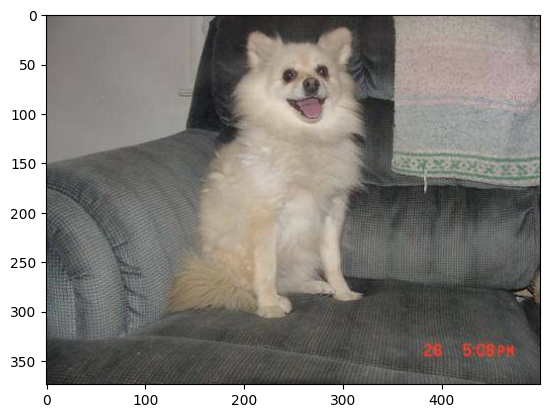

File classified 'dogs\dog.5132.jpg' as 'CAT' [0.7236662 0.2763338]


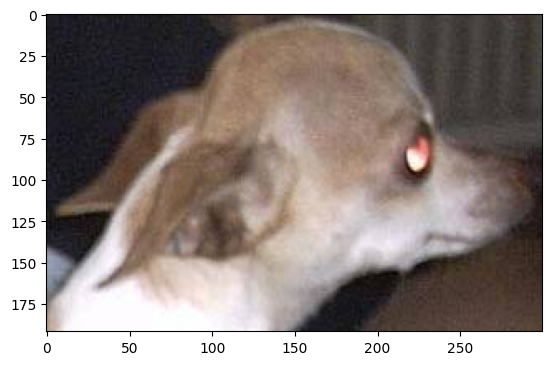

File classified 'dogs\dog.5336.jpg' as 'CAT' [0.91142875 0.08857121]


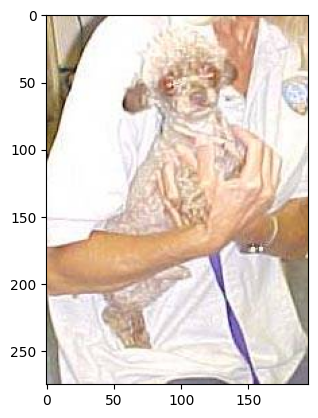

File classified 'dogs\dog.5614.jpg' as 'CAT' [0.6347309 0.3652691]


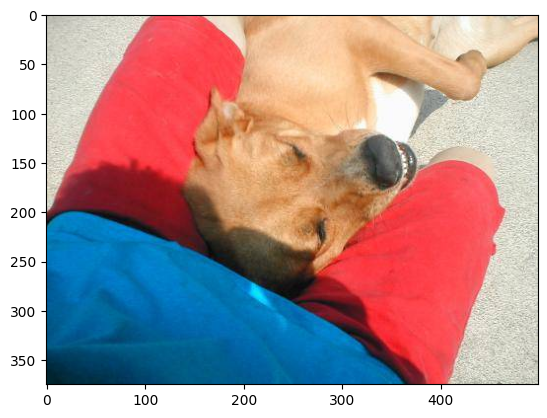

File classified 'dogs\dog.5767.jpg' as 'CAT' [9.997310e-01 2.690376e-04]


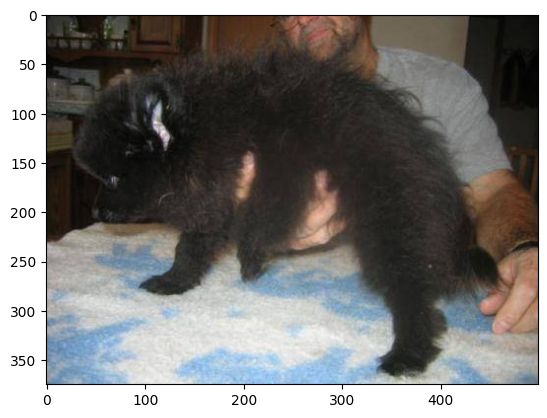

File classified 'dogs\dog.6568.jpg' as 'CAT' [0.7834471  0.21655287]


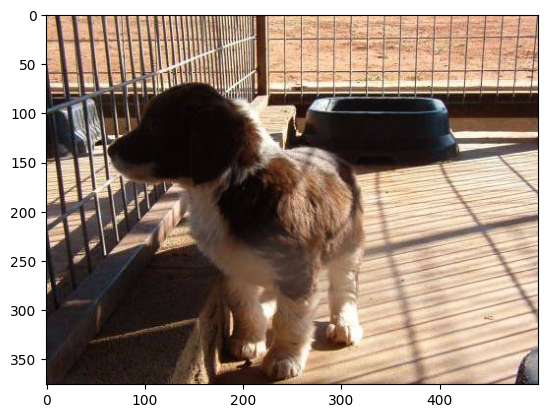

File classified 'dogs\dog.669.jpg' as 'CAT' [0.7554625  0.24453747]


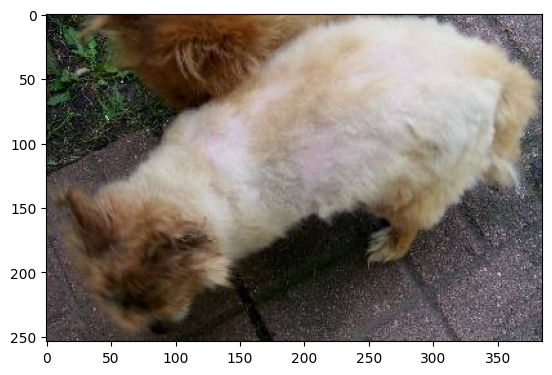

File classified 'dogs\dog.7913.jpg' as 'CAT' [0.9847638  0.01523621]


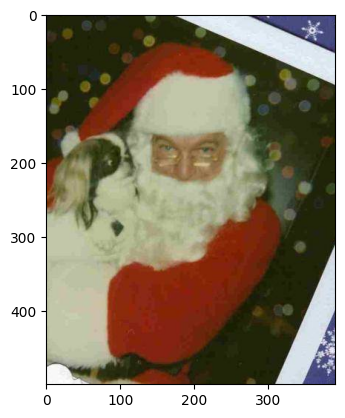

File classified 'dogs\dog.8311.jpg' as 'CAT' [0.72918326 0.2708167 ]


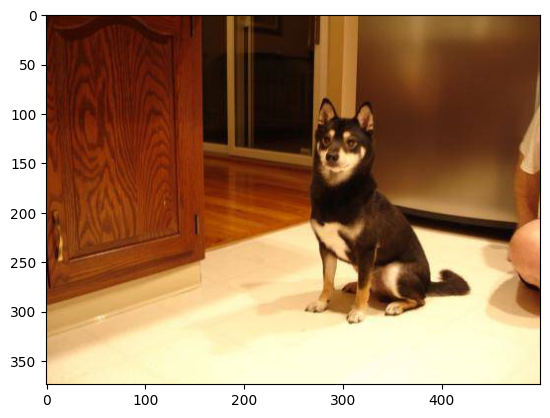

File classified 'dogs\dog.8507.jpg' as 'CAT' [9.9998546e-01 1.4593899e-05]


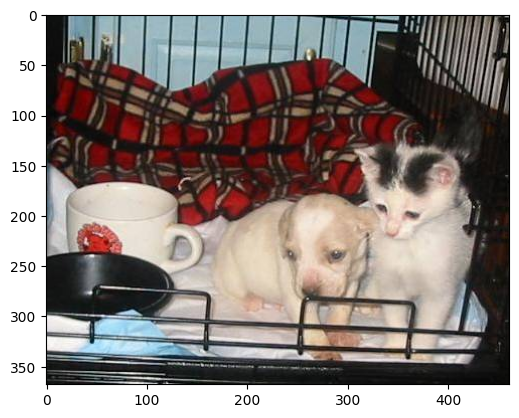

File classified 'dogs\dog.9221.jpg' as 'CAT' [0.87114036 0.12885962]


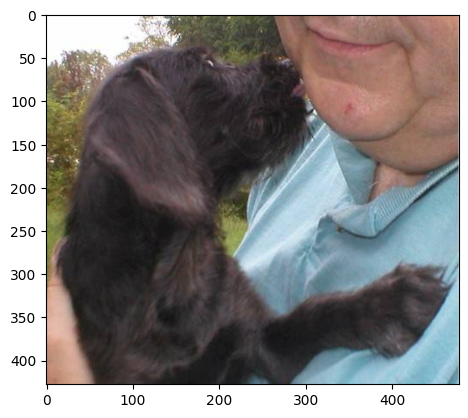

File classified 'dogs\dog.9288.jpg' as 'CAT' [0.5364191 0.4635809]


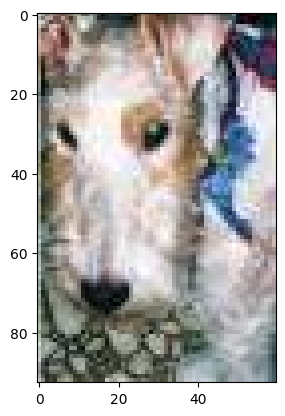

File classified 'dogs\dog.9377.jpg' as 'CAT' [0.736939   0.26306093]


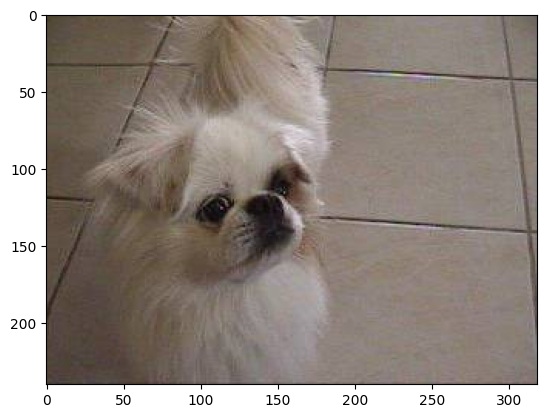

File classified 'dogs\dog.9683.jpg' as 'CAT' [0.9411265 0.0588735]


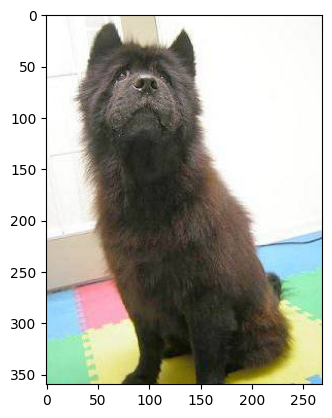

File classified 'dogs\dog.990.jpg' as 'CAT' [0.7683963  0.23160365]


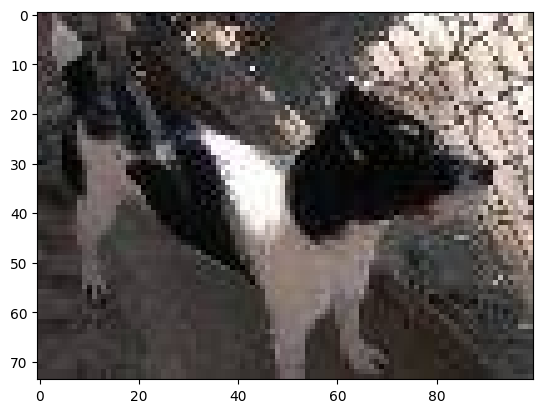

In [9]:
# Verificando imagens que possuem o label de cachorro, mas foram classificadas como gato
for cat in cats:
    try:
        image_path = 'C:\\Users\\mathe\\OneDrive\\Documents\\Faculdade\\PML\\dataset\\test\\' + cat[0]
        print(f'File classified \'{cat[0]}\' as \'CAT\' { cat[1] }')
        
        img = mpimg.imread(image_path)
        plt.imshow(img)
        plt.show()
    except FileNotFoundError:
        print('File not found')

### Gatos que foram classificados como cachorros.

In [30]:
results_cats = predictor.predict_folder('C:\\Users\\mathe\\OneDrive\\Documents\\Faculdade\\PML\\dataset\\test\\cats', return_proba=True)

Found 3720 images belonging to 1 classes.


É possível observar, novamente, que o *dataset* possui erros de rotulamento em seus dados.

In [31]:
dogs = []

for dog in results_cats:
    if dog[1][1] > 0.5:
        dogs.append(dog)

print(len(dogs))

25


File classified 'cats\cat (3121).jpg' as 'DOG' [0.00111568 0.9988844 ]


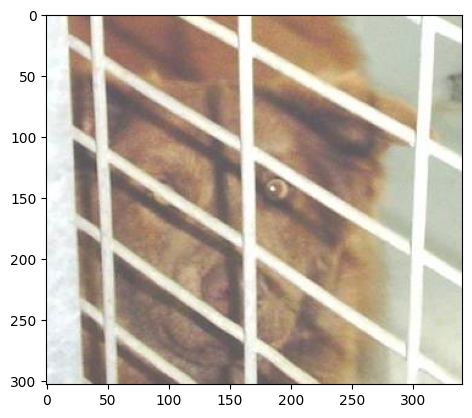

File classified 'cats\cat (3828).jpg' as 'DOG' [0.05778681 0.9422132 ]


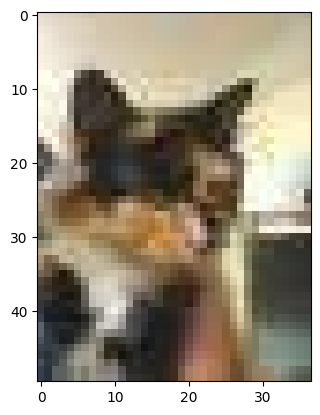

File classified 'cats\cat (5183).jpg' as 'DOG' [0.06776343 0.9322366 ]


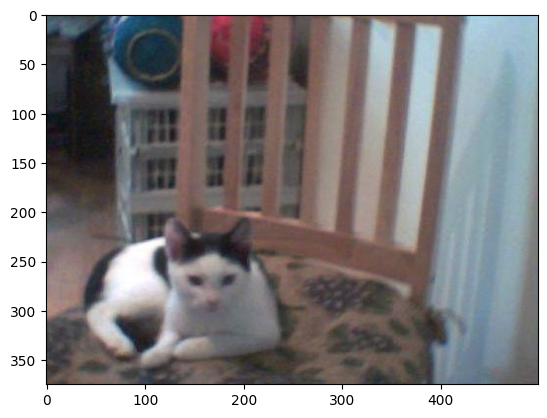

File classified 'cats\cat (5545).jpg' as 'DOG' [0.10740574 0.8925943 ]


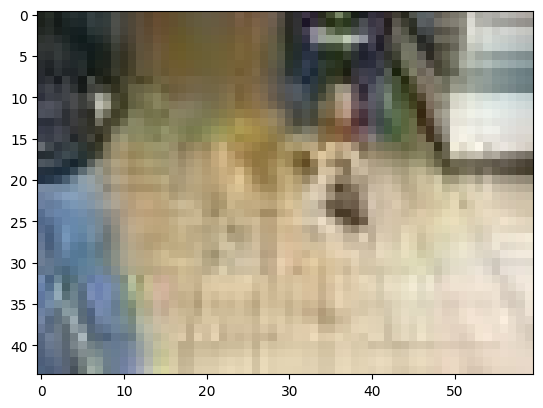

File classified 'cats\cat.10029.jpg' as 'DOG' [0.18749829 0.8125017 ]


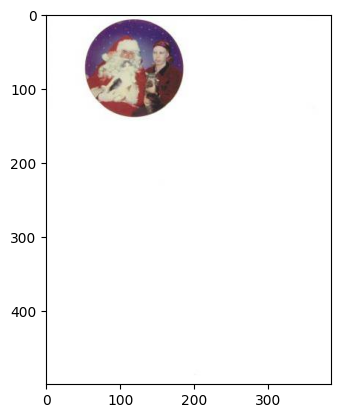

File classified 'cats\cat.11222.jpg' as 'DOG' [9.603498e-14 1.000000e+00]


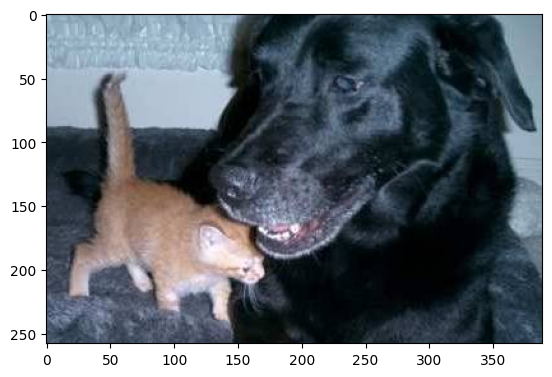

File classified 'cats\cat.11243.jpg' as 'DOG' [0.24229097 0.757709  ]


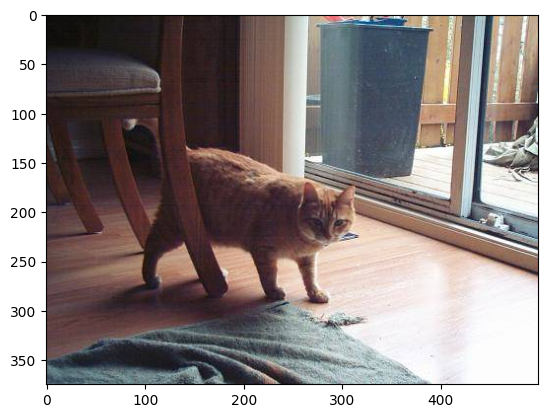

File classified 'cats\cat.11281.jpg' as 'DOG' [0.08817233 0.91182774]


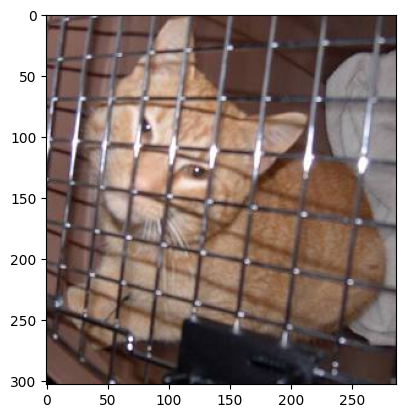

File classified 'cats\cat.11297.jpg' as 'DOG' [0.35174605 0.6482539 ]


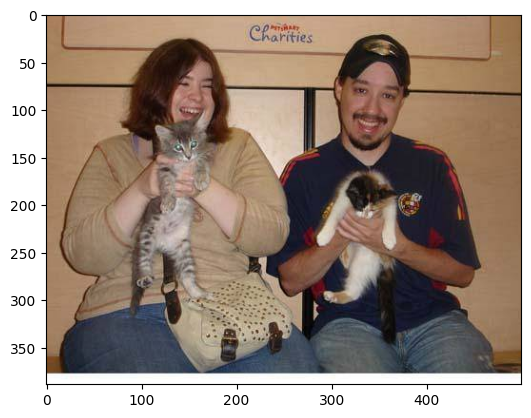

File classified 'cats\cat.12378.jpg' as 'DOG' [0.04470102 0.95529896]


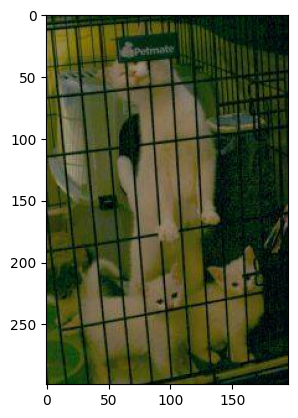

File classified 'cats\cat.12499.jpg' as 'DOG' [0.22980241 0.77019763]


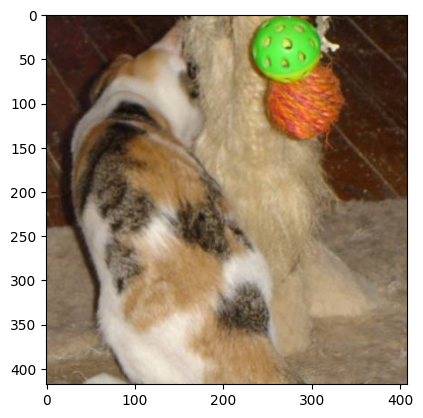

File classified 'cats\cat.2267.jpg' as 'DOG' [0.00806716 0.9919328 ]


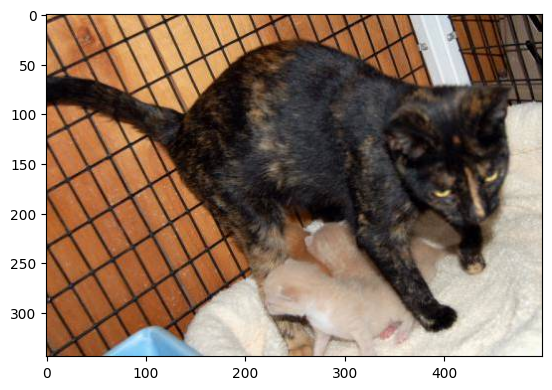

File classified 'cats\cat.2342.jpg' as 'DOG' [0.41032085 0.5896791 ]


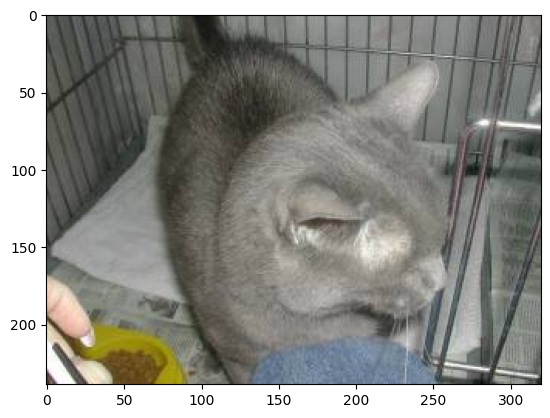

File classified 'cats\cat.2748.jpg' as 'DOG' [0.0844738 0.9155262]


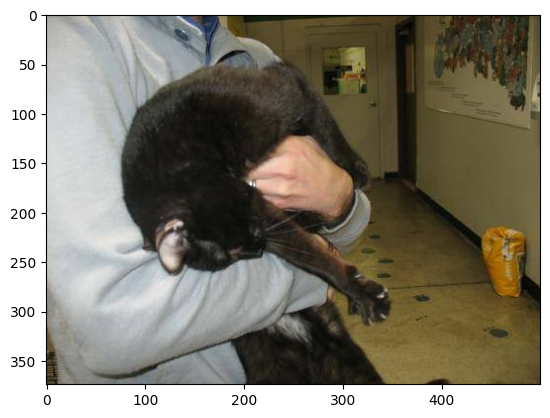

File classified 'cats\cat.2950.jpg' as 'DOG' [0.44272545 0.5572745 ]


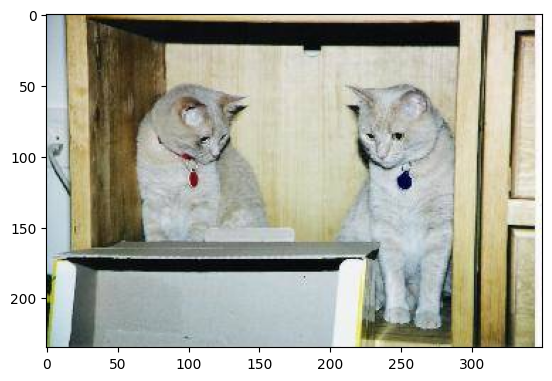

File classified 'cats\cat.4190.jpg' as 'DOG' [0.00267871 0.9973213 ]


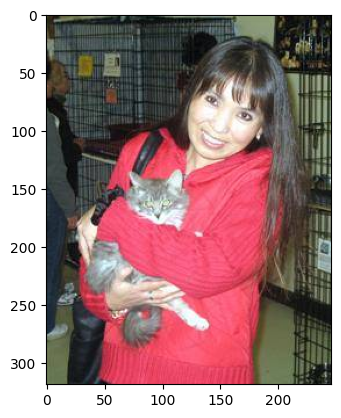

File classified 'cats\cat.5048.jpg' as 'DOG' [0.3216848 0.6783152]


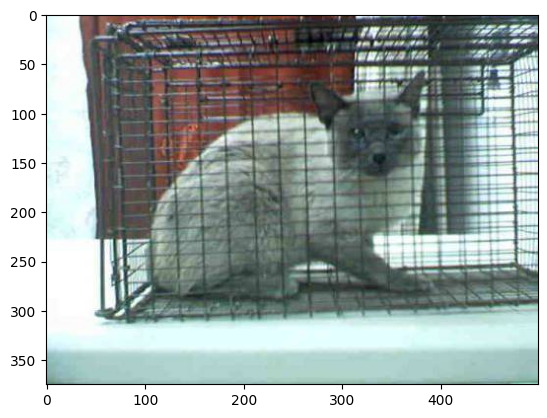

File classified 'cats\cat.5173.jpg' as 'DOG' [0.03278645 0.9672135 ]


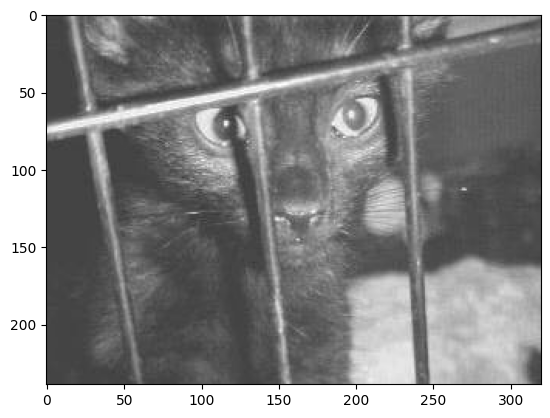

File classified 'cats\cat.5347.jpg' as 'DOG' [0.00412164 0.99587834]


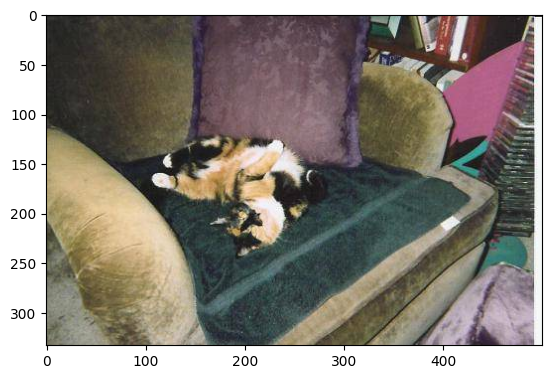

File classified 'cats\cat.7111.jpg' as 'DOG' [0.30043757 0.69956243]


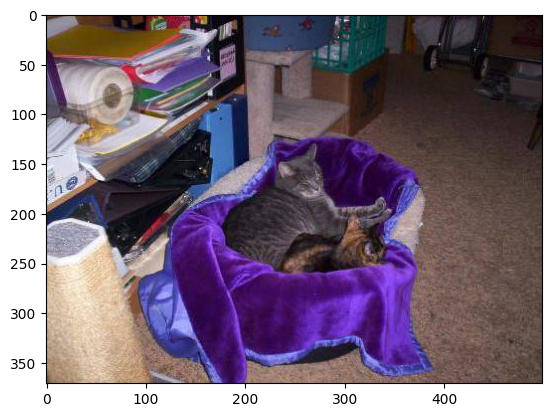

File classified 'cats\cat.7564.jpg' as 'DOG' [0.08863886 0.9113611 ]


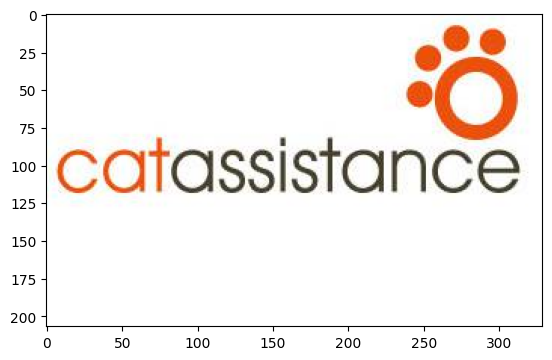

File classified 'cats\cat.7602.jpg' as 'DOG' [0.41162598 0.588374  ]


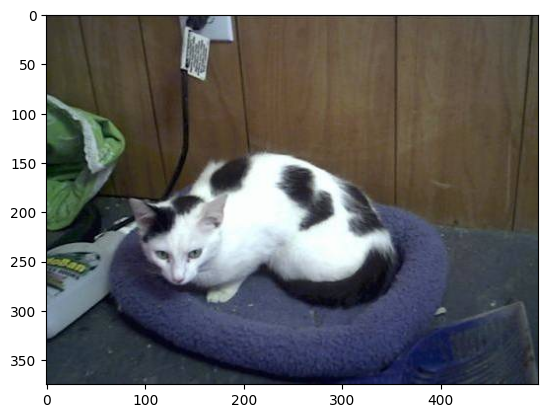

File classified 'cats\cat.9277.jpg' as 'DOG' [0.19440366 0.80559635]


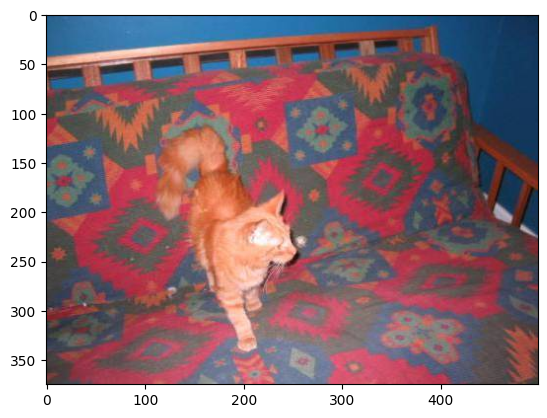

File classified 'cats\cat.934.jpg' as 'DOG' [0.16932657 0.83067346]


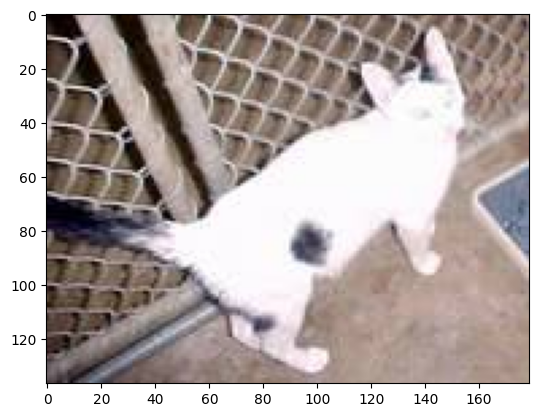

File classified 'cats\cat.96.jpg' as 'DOG' [0.3460382  0.65396184]


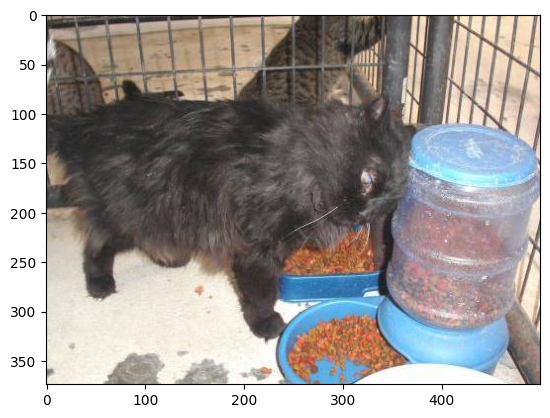

In [32]:
# Verificando imagens que possuem o label de gato, mas foram classificadas como cachorro
for dog in dogs:
    try:
        image_path = 'C:\\Users\\mathe\\OneDrive\\Documents\\Faculdade\\PML\\dataset\\test\\' + dog[0]
        print(f'File classified \'{dog[0]}\' as \'DOG\' { dog[1] }')
        
        img = mpimg.imread(image_path)
        plt.imshow(img)
        plt.show()
    except FileNotFoundError:
        print('File not found')

### Análise

Analisando os erros é possível observar um possível viés na coleta dos dados, visto que o modelo tende a predizer<br>
imagens que possuem uma espécie de grade ou gaiola como sendo cachorros.<br><br> 
Observa-se também um comportamento parecido quando as imagens possuem pessoas.


# Realizando testes com outro dataset.<br>
Visto que o *dataset* utilizado possui um possível viés, foram realizados testes com outro *dataset*.

In [34]:
results_dogs = predictor.predict_folder('C:\\Users\\mathe\\OneDrive\\Documents\\Faculdade\\PML\\dataset\\test2\\dogs', return_proba=True)

Found 340 images belonging to 1 classes.


In [35]:
cats = []

for element in results_dogs:
    if element[1][1] < 0.5 :
        cats.append(element)

print(len(cats))

6


File classified 'dogs\dog_109.jpg' as 'CAT' [0.7467557  0.25324428]


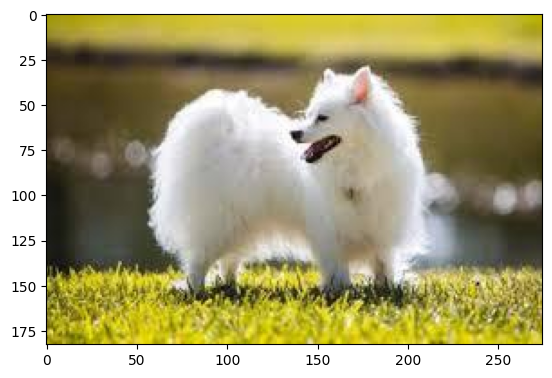

File classified 'dogs\dog_292.jpg' as 'CAT' [0.9976604  0.00233955]


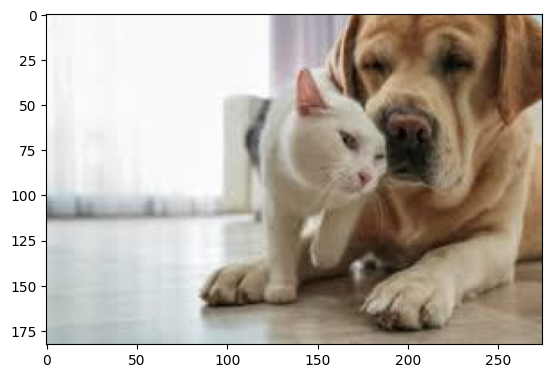

File classified 'dogs\dog_341.jpg' as 'CAT' [0.9073486  0.09265143]


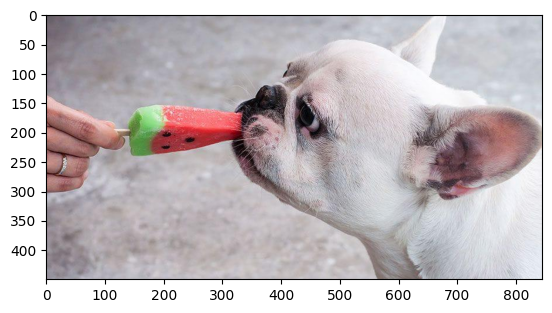

File classified 'dogs\dog_345.jpg' as 'CAT' [0.9778178  0.02218216]


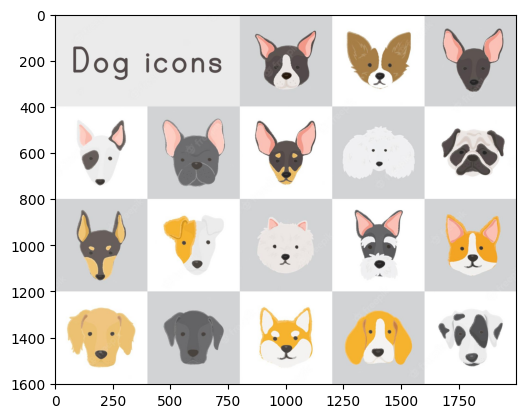

File classified 'dogs\dog_418.jpg' as 'CAT' [0.50882536 0.49117467]


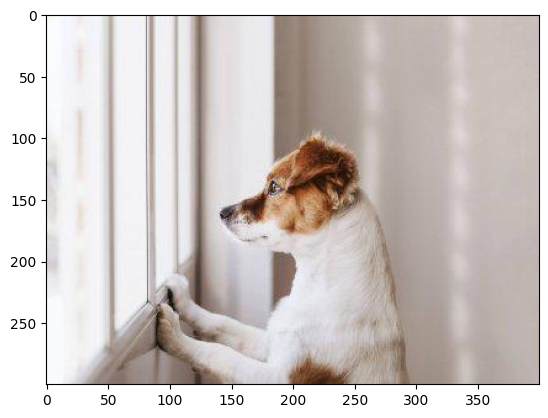

File classified 'dogs\dog_505.jpg' as 'CAT' [0.73108053 0.26891947]


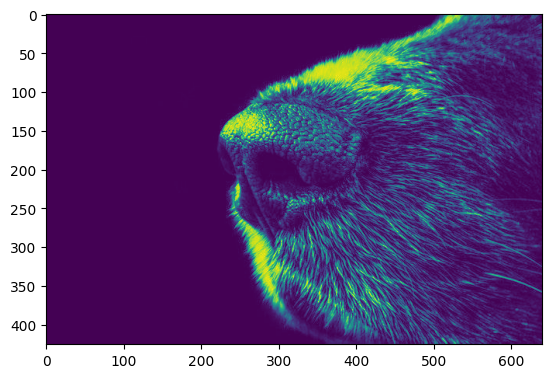

In [36]:
# Verificando imagens que possuem o label de cachorro, mas foram classificadas como gato
for cat in cats:
    try:
        image_path = 'C:\\Users\\mathe\\OneDrive\\Documents\\Faculdade\\PML\\dataset\\test2\\' + cat[0]
        print(f'File classified \'{cat[0]}\' as \'CAT\' { cat[1] }')
        
        img = mpimg.imread(image_path)
        plt.imshow(img)
        plt.show()
    except FileNotFoundError:
        print('File not found')

In [37]:
results_cats = predictor.predict_folder('C:\\Users\\mathe\\OneDrive\\Documents\\Faculdade\\PML\\dataset\\test2\\cats', return_proba=True)

Found 336 images belonging to 1 classes.


In [38]:
dogs = []

for dog in results_cats:
    if dog[1][1] > 0.5:
        dogs.append(dog)

print(len(dogs))

8


File classified 'cats\cat_116.jpg' as 'DOG' [0.14475696 0.8552431 ]


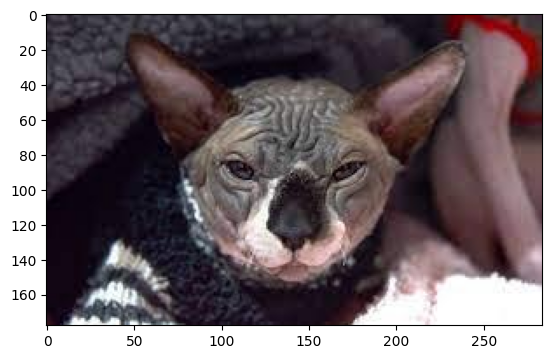

File classified 'cats\cat_161.jpg' as 'DOG' [0.22855404 0.771446  ]


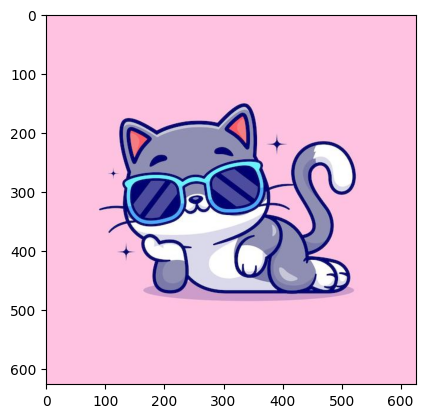

File classified 'cats\cat_232.jpg' as 'DOG' [0.4627123  0.53728765]


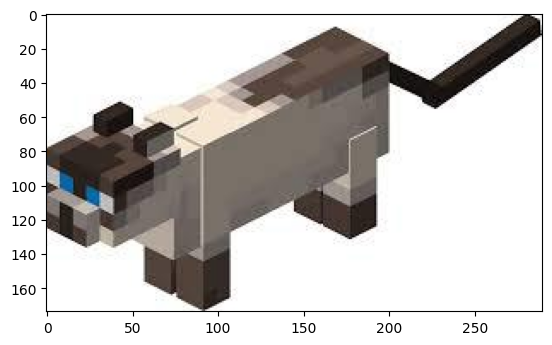

File classified 'cats\cat_280.jpg' as 'DOG' [0.3227242 0.6772758]


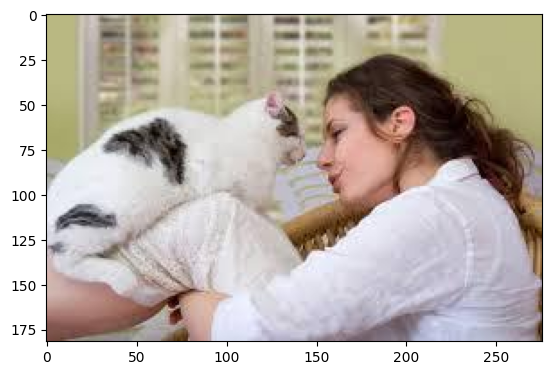

File classified 'cats\cat_464.jpg' as 'DOG' [0.11651038 0.88348955]


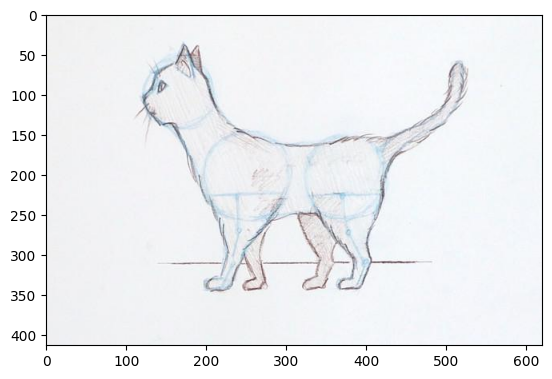

File classified 'cats\cat_510.jpg' as 'DOG' [0.09766236 0.9023376 ]


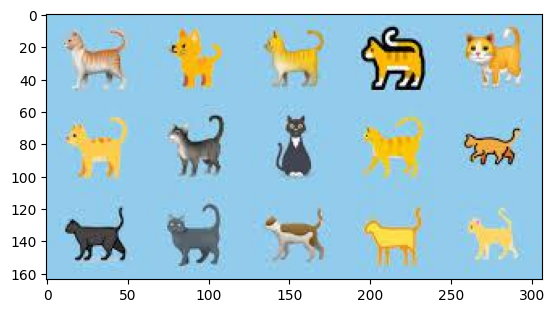

File classified 'cats\cat_548.jpg' as 'DOG' [0.413508 0.586492]


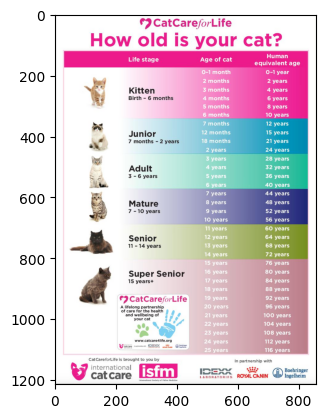

File classified 'cats\cat_595.jpg' as 'DOG' [0.44759795 0.5524021 ]


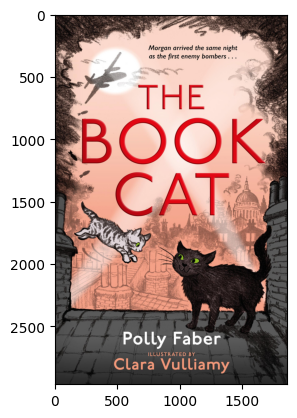

In [39]:
# Verificando imagens que possuem o label de gato, mas foram classificadas como cachorro
for dog in dogs:
    try:
        image_path = 'C:\\Users\\mathe\\OneDrive\\Documents\\Faculdade\\PML\\dataset\\test2\\' + dog[0]
        print(f'File classified \'{dog[0]}\' as \'DOG\' { dog[1] }')
        
        img = mpimg.imread(image_path)
        plt.imshow(img)
        plt.show()
    except FileNotFoundError:
        print('File not found')

# Gerando a matriz de confusão.

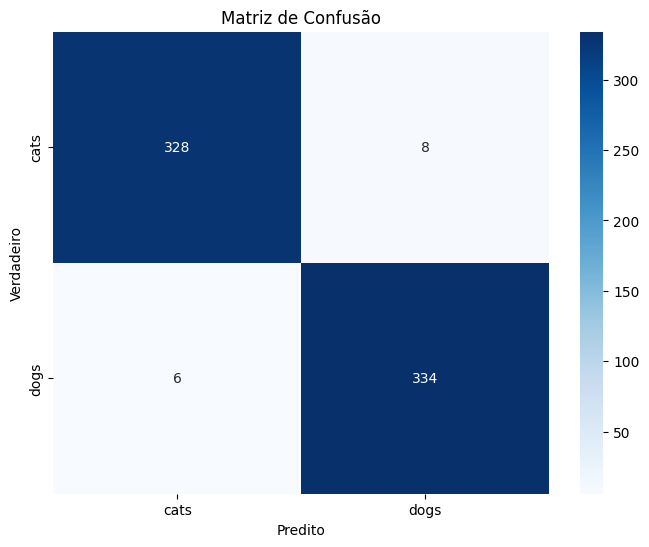

Acuracia do teste 2: 0.9792899408284024


In [55]:
acc = 1 - (len(dogs) + len(cats)) / (len(results_cats) + len(results_dogs))
cm = [
        [len(results_cats) - len(dogs), len(dogs)],
        [len(cats), len(results_dogs) - len(cats)]
     ]  

# Plotar a matriz de confusão
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=['cats', 'dogs'], yticklabels=['cats', 'dogs'])
plt.title('Matriz de Confusão')
plt.xlabel('Predito')
plt.ylabel('Verdadeiro')
plt.show()

print(f"Acuracia do teste 2: {acc}")